# mount the data needed to drive folder so we can use them in colab

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Display image

(256, 256, 3)


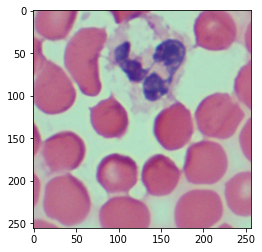

In [ ]:
import glob
import cv2
import matplotlib.pyplot as plt
image = cv2.imread('/content/drive/MyDrive/images/image-1.png')
image = image[:,:,2::-1]
print(image.shape)
plt.imshow(image)


Display the annotation file 

In [ ]:
import pandas as pd
annotation = pd.read_csv("/content/drive/MyDrive/images/annotations.csv")
annotation.head()

,image,xmin,ymin,xmax,ymax,label
0,image-100.png,0.000000,0.000000,25.190198,40.816803,rbc
1,image-100.png,15.010502,0.000000,68.337223,23.527421,rbc
2,image-100.png,25.017503,16.021004,78.374562,73.735123,rbc
3,image-100.png,75.565928,1.061844,140.248541,45.591599,rbc
4,image-100.png,77.483081,23.290548,131.936989,74.806301,rbc


Setup the YOLOV5 

In [ ]:
# clone YOLOV5
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5

!pip install  -r requirements.txt  # install dependencies
!pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output    # to display image


# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Cloning into 'yolov5'...
remote: Enumerating objects: 12173, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 12173 (delta 0), reused 5 (delta 0), pack-reused 12167
Receiving objects: 100% (12173/12173), 11.91 MiB | 32.79 MiB/s, done.
Resolving deltas: 100% (8428/8428), done.
/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 596 kB 5.2 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
     |████████████████████████████████| 145 kB 5.1 MB/s 
     |████████████████████████████████| 178 kB 40.6 MB/s 
     |████████████████████████████████| 1.1 MB 63.7 MB/s 
     |████████████████████████████████| 67 kB 7.2 MB/s 
     |████████████████████████████████| 54 kB 3.2 MB/s 
     |████████████████████████████████| 138 kB 72.3 MB/

Import  Roboflow 





In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultraytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultraytics


Setup the dataset enviroment

In [ ]:
# setup envaroment
os.environ["DATASET_DIRECTORY"] = '/content/datasets'

Put data from roboflow to my drive

In [ ]:

rf = Roboflow(api_key="LPxmmlTxW037qMhy2rXw")
project = rf.workspace("ali-egz2q").project("123-qa1w0")
dataset = project.version(1).download("yolov5")

#rf = Roboflow(api_key="7A4OZLwuyXMgbuAIYEpK")
#project = rf.workspace().project("cell-clacification")
#dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/123-1 in yolov5pytorch:: 100%|██████████| 209/209 [00:00<00:00, 2122.65it/s]


Run the training

In [ ]:
!python train.py --data {dataset.location}/data.yaml --batch-size 4 --epochs 300 --img-size 416 --weights weights/yolov5s.pt --cache

train: weights=weights/yolov5s.pt, cfg=, data=/content/datasets/123-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=4, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-244-g47233e1 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, h

Show training result

In [ ]:
# start Tensorboard
#Launch after you have start training
#Logs save in the folder 'runs'
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

Prediction 

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/valid/images

python3: can't open file 'detect.py': [Errno 2] No such file or directory


In [ ]:
# start Tensorboard
#Launch after you have start training
#Logs save in the folder 'runs'
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 588), started 0:04:00 ago. (Use '!kill 588' to kill it.)

<IPython.core.display.Javascript object>

Display inference images 

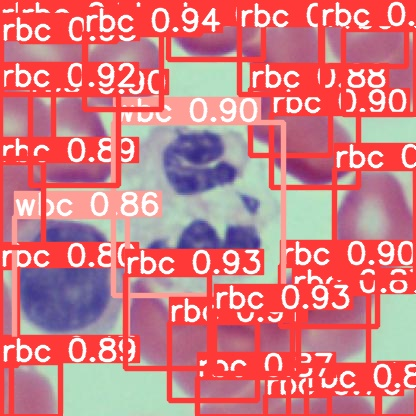

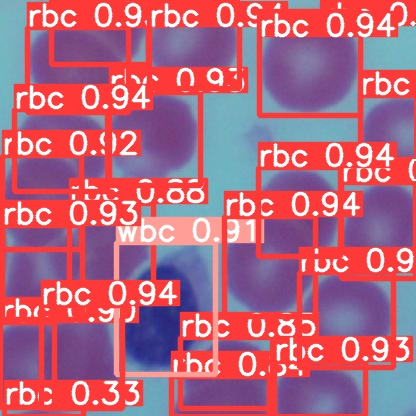

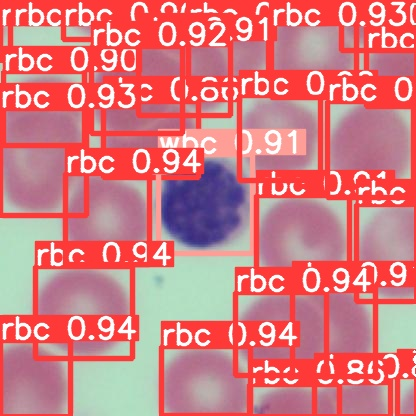

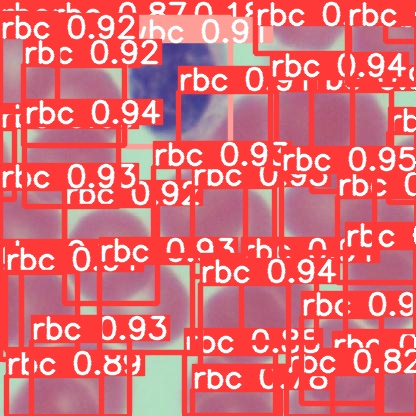

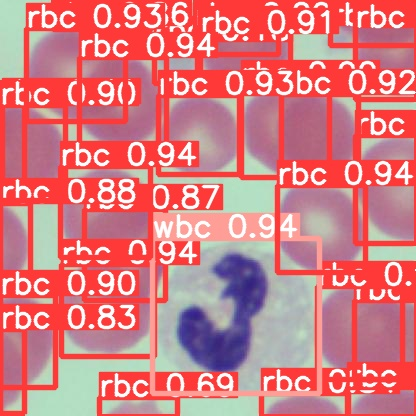

...

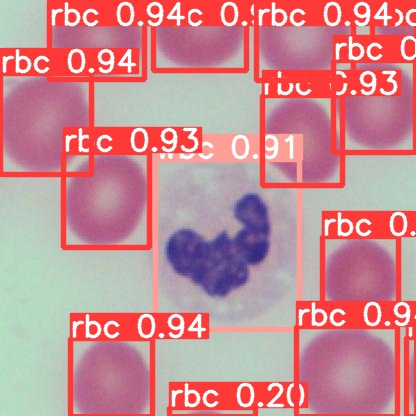

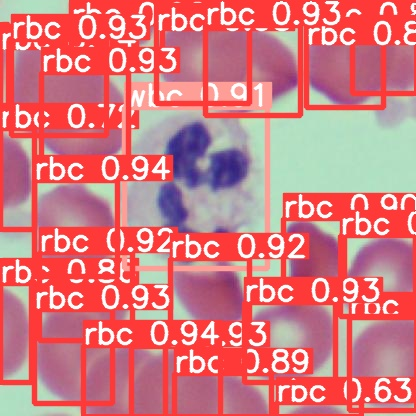

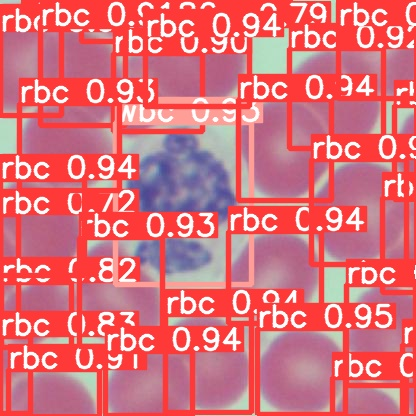

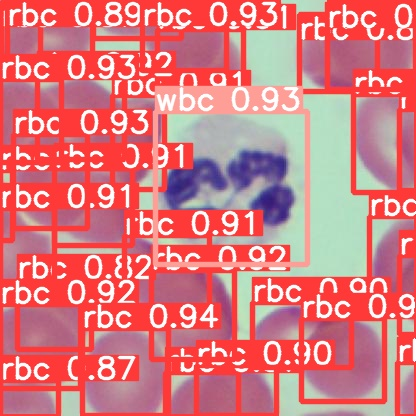

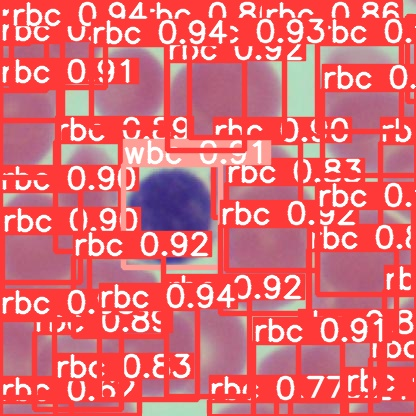

In [ ]:
import glob 
from IPython.display import display
i = 0
# choose the correct exp folder - see prev output block
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'):
  i+=1
  if i < 20:
    display(Image(filename = imageName))

  print('\n')



Save Model

In [ ]:
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>